In [1]:
# Copyright (c) Meta Platforms, Inc. and affiliates.
# Once the repo is cloned then:
#best practice remove and reeinstal fspec


# # instal using the setup.py inside the sam2 repo
# pip install e .
# pip install -e ".[demo]"


# #install also to vizualize figures
# !sudo apt-get update
# !sudo apt-get install -y libgl1-mesa-glx
# !sudo apt-get install -y libglib2.0-0

# #Necessary dependencies
# !rm -rf /opt/conda/lib/python3.10/site-packages/fsspec*
# !pip install fsspec==2024.6.1 --force-reinstall --no-deps
# !pip install shapely
# !pip install s3fs
# !pip install rasterio

## Running an example of general segmentation using SAM2

In this example, the model segments everything it finds in the image.


In [2]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image


# select the device for computation
device = torch.device("cuda")  #U-net trained on cuda

### Geting the image from Solafune competition uploaded to my s3 bucket

In [3]:
import rasterio
import numpy as np

def load_image_as_array(image_s3_uri):
    """Load an image from S3 and convert it to a NumPy array."""
    # Open the image using rasterio
    with rasterio.open(image_s3_uri) as src:
        # Read the image data
        image = src.read()  # This will read all the bands
        image = np.moveaxis(image, 0, -1)  # Move channels to the last dimension
        image = image[:, :, :3]  # Assuming you want to use only the first 3 bands (R, G, B)
    return image


np.random.seed(3)

def show_anns(anns, borders=True):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:, :, 3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.5]])
        img[m] = color_mask 
        if borders:
            import cv2
            contours, _ = cv2.findContours(m.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
            # Try to smooth contours
            contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
            cv2.drawContours(img, contours, -1, (0, 0, 1, 0.4), thickness=1) 

    ax.imshow(img)


# Example
image_s3_uri = 's3://solafune/test_images/images/test_0.tif'
image = load_image_as_array(image_s3_uri)

# Now 'image' is a NumPy array in RGB format
print(image.shape)  # This will print the shape of the image array


# Assuming 'image' is the array you loaded
image_normalized = (image - np.min(image)) / (np.max(image) - np.min(image)) * 255
image_normalized = image_normalized.astype(np.uint8)  # Convert to uint8

image = image_normalized

(802, 1171, 3)


### Generating a Binary Mask

In [4]:
#Setting the U-net architecture
import torch
import torch.nn as nn
import torch.nn.functional as F

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),  # Batch Normalization
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),  # Batch Normalization
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(Down, self).__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels)
        else:
            self.up = nn.ConvTranspose2d(in_channels // 2, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.inc = nn.Sequential(DoubleConv(n_channels, 64), nn.Dropout(0.5))  # Added Dropout
        self.down1 = Down(64, 128)
        self.down2 = Down(128, 256)
        self.down3 = Down(256, 512)
        self.down4 = Down(512, 512)
        self.up1 = Up(1024, 256)
        self.up2 = Up(512, 128)
        self.up3 = Up(256, 64)
        self.up4 = Up(128, 64)
        self.outc = OutConv(64, n_classes)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        logits = self.outc(x)
        return logits

# Initialize the model weights
def init_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)
        nn.init.constant_(m.bias, 0)

class EarlyStopping:
    def __init__(self, patience=3, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.best_loss = None
        self.counter = 0

    def step(self, loss):
        if self.best_loss is None or loss < self.best_loss - self.min_delta:
            self.best_loss = loss
            self.counter = 0
        else:
            self.counter += 1

        if self.counter >= self.patience:
            return True
        return False



In [5]:
def generate_binary_mask(image, model, device, threshold=0.5):
    """
    Generates a binary mask from the given image using the provided model.
    """
    # Preprocess image for model input
    original_shape = image.shape[:2]
    image = torch.tensor(image, dtype=torch.float32).permute(2, 0, 1) / 255.0
    image = image.unsqueeze(0)  # Add batch dimension
    image = image.to(device)
    
    with torch.no_grad():  # Disable gradient computation for inference
        output = model(image)
        prediction = torch.sigmoid(output)  # Apply sigmoid to get probabilities
        prediction = prediction.squeeze(0).cpu().numpy()  # Remove batch dimension and move to CPU
    
    # Apply threshold to get binary mask
    binary_mask = (prediction > threshold).astype(np.uint8)
    
    # Resize the binary mask to match the original image dimensions (if necessary)
    binary_mask = F.interpolate(torch.tensor(binary_mask[0]).unsqueeze(0).unsqueeze(0).float(), size=original_shape, mode='bilinear', align_corners=False).squeeze().numpy()
    
    return binary_mask


In [6]:
# Load your trained model (use the latest checkpoint)
model = UNet(n_channels=3, n_classes=1).to(device)
model.load_state_dict(torch.load("Model_best_kfold.pth"))  # Adjust filename if needed
model.eval()  # Set the model to evaluation mode


/tmp/ipykernel_1406/2620901831.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("Model_best_kfold.pth"))  # Adjust filename if needed


UNet(
  (inc): Sequential(
    (0): DoubleConv(
      (double_conv): Sequential(
        (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
    (1): Dropout(p=0.5, inplace=False)
  )
  (down1): Down(
    (maxpool_conv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): DoubleConv(
        (double_conv): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3)

In [9]:
# Preprocess image and generate binary mask using the trained model
binary_mask = generate_binary_mask(image, model, device, 0.9)

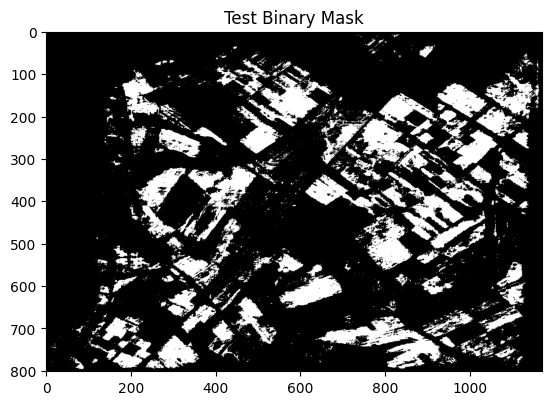

In [10]:
# If you want to visualize the binary mask
import matplotlib.pyplot as plt
plt.imshow(binary_mask, cmap='gray')
plt.title('Test Binary Mask')
plt.show()


# Creating a Custom Class CustomSAM2AutomaticMaskGenerator

In [11]:
from sam2.build_sam import build_sam2
from custom_sam2_classes import CustomSAM2AutomaticMaskGenerator
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator


sam2_checkpoint = "./segment-anything-2/checkpoints/sam2_hiera_large.pt" # try large sam2_hiera_large.pt
model_cfg = "sam2_hiera_l.yaml" #"sam2_hiera_l.yaml" for large

sam2 = build_sam2(model_cfg, sam2_checkpoint, device=device, apply_postprocessing=False)

mask_generator = CustomSAM2AutomaticMaskGenerator(sam2,
                                                        points_per_side=64,  # Increased for finer sampling
                                                        points_per_batch=128,  # Adjusted based on GPU memory
                                                        pred_iou_thresh=0.8,
                                                        stability_score_thresh=0.9,  # Slightly lowered to allow more masks
                                                        stability_score_offset=1.0,
                                                        mask_threshold=0.1,  # Slightly increased for more confident masks
                                                        box_nms_thresh=0.7,
                                                        crop_n_layers=2,  # Enable cropping for finer mask generation
                                                        crop_nms_thresh=0.7,
                                                        crop_overlap_ratio=0.3,  # Adjusted for better coverage
                                                        crop_n_points_downscale_factor=1,
                                                        point_grids=None,
                                                        min_mask_region_area=100,  # To remove small disconnected areas
                                                        output_mode="binary_mask",
                                                        use_m2m=False,
                                                        multimask_output=True,  # Keep as True for more options
                                                        )

mask_generator_original = SAM2AutomaticMaskGenerator(sam2)


/home/sagemaker-user/solafune_field_segmentation/segment-anything-2/sam2/modeling/sam/transformer.py:23: UserWarning: Flash Attention is disabled as it requires a GPU with Ampere (8.0) CUDA capability.
  OLD_GPU, USE_FLASH_ATTN, MATH_KERNEL_ON = get_sdpa_settings()


In [12]:

masks_processed = mask_generator.generate(image,binary_mask)

masks_not_processed = mask_generator_original.generate(image)

/home/sagemaker-user/solafune_field_segmentation/segment-anything-2/sam2/sam2_image_predictor.py:431: UserWarning: cannot import name '_C' from 'sam2' (/home/sagemaker-user/solafune_field_segmentation/segment-anything-2/sam2/__init__.py)

Skipping the post-processing step due to the error above. You can still use SAM 2 and it's OK to ignore the error above, although some post-processing functionality may be limited (which doesn't affect the results in most cases; see https://github.com/facebookresearch/segment-anything-2/blob/main/INSTALL.md).
  masks = self._transforms.postprocess_masks(


KeyboardInterrupt: 

In [ ]:
print(len(masks_processed))
print(masks_processed[0].keys())

In [ ]:
plt.figure(figsize=(16, 9))

# Show the image
plt.subplot(1, 2, 1)
plt.imshow(image)
show_anns(masks_not_processed)
plt.title("Not Processed")
plt.axis('off')

# Show the masks overlayed on the image
plt.subplot(1, 2, 2)
plt.imshow(image)
show_anns(masks_processed)
plt.title("Processed")
plt.axis('off')

plt.show()

# Creating the binary masks

Using a trained U-net model we get binary masks to select possible fied areas.

In [13]:
import json
import s3fs
from io import BytesIO
from PIL import Image
import numpy as np
import cv2
from shapely.geometry import Polygon

def mask_to_polygon(mask):
    """
    Convert a binary mask into a polygon.
    """
    contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    polygons = []
    for contour in contours:
        if contour.shape[0] > 2:  # Ensure it's a valid polygon with at least 3 points
            polygons.append(contour.squeeze(1).tolist())
    return polygons

def process_images_and_convert_to_json(mask_generator,model,threshold = 0.7):
    # Initialize the root structure
    data = {
        "images": []
    }

    # Process each image file in the sequence
    for i in range(50):  # Assuming files are named test_0.tiff to test_50.tiff
        filename = f"test_{i}.tif"
        image_s3_uri = f's3://solafune/test_images/images/{filename}'

        print(f'Processing image {filename}')
        # Check if the current file is test_1.tif and skip processing
        if filename == "test_1.tif":
            print(f"Skipping processing for {filename}. Adding empty annotations.")
            data["images"].append({
                "file_name": filename,
                "annotations": []
            })
            continue
        
        # Load the image as a NumPy array using your working method
        image = load_image_as_array(image_s3_uri)
            
        # Normalize the image
        image_normalized = (image - np.min(image)) / (np.max(image) - np.min(image)) * 255
        image_normalized = image_normalized.astype(np.uint8)  # Convert to uint8

        # Now 'image' is the normalized image
        image = image_normalized

        # Preprocess image and generate binary mask using the trained model
        binary_mask = generate_binary_mask(image, model, device, threshold)

        try:
            # Generate masks for the current image using SAM and the binary mask
            masks = mask_generator.generate(image, binary_mask)
    
        except Exception as e:
            print(f"KeyError encountered for {filename}: {e}. Retrying with a lower threshold...")
            # Retry with a threshold that is 50% less
            lower_threshold = threshold * 0.5
            binary_mask = generate_binary_mask(image, model, device, lower_threshold)
            masks = mask_generator.generate(image, binary_mask)
            
        # Convert masks to polygons
        polygons = []
        for mask_dict in masks:
            mask = mask_dict.get("segmentation")  # Assuming the mask is under the 'segmentation' key
            if mask is not None:
                polygons.extend(mask_to_polygon(mask))
        
        # Prepare JSON structure for this image
        image_entry = {
            "file_name": filename,
            "annotations": []
        }
        
        for polygon in polygons:
            annotation = {
                "class": "field",
                "segmentation": [coord for point in polygon for coord in point]
            }
            image_entry["annotations"].append(annotation)

        # Add the image entry to the root structure
        data["images"].append(image_entry)
            

    
    # Save the final JSON structure
    json_output_path = 'final_predictions_pps_90.json'
    with open(json_output_path, 'w') as f:
        json.dump(data, f, indent=2)
    print(f"Saved final predictions to {json_output_path}")

    return data


In [14]:
import torch

# Set device (GPU or CPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load your trained model (use the latest checkpoint)
model = UNet(n_channels=3, n_classes=1).to(device)
model.load_state_dict(torch.load("Model_best_kfold.pth"))  # Adjust filename if needed
model.eval()  # Set the model to evaluation mode


# Process images and convert to JSON
json_data = process_images_and_convert_to_json(mask_generator, model, 0.9)

# json_data now contains the structured annotation information


Processing image test_0.tif


/home/sagemaker-user/solafune_field_segmentation/segment-anything-2/sam2/sam2_image_predictor.py:431: UserWarning: cannot import name '_C' from 'sam2' (/home/sagemaker-user/solafune_field_segmentation/segment-anything-2/sam2/__init__.py)

Skipping the post-processing step due to the error above. You can still use SAM 2 and it's OK to ignore the error above, although some post-processing functionality may be limited (which doesn't affect the results in most cases; see https://github.com/facebookresearch/segment-anything-2/blob/main/INSTALL.md).
  masks = self._transforms.postprocess_masks(


Processing image test_1.tif
Skipping processing for test_1.tif. Adding empty annotations.
Processing image test_2.tif
KeyError encountered for test_2.tif: 'boxes'. Retrying with a lower threshold...
Processing image test_3.tif
Processing image test_4.tif
Processing image test_5.tif
Processing image test_6.tif
Processing image test_7.tif
KeyError encountered for test_7.tif: 'boxes'. Retrying with a lower threshold...
Processing image test_8.tif
Processing image test_9.tif
Processing image test_10.tif
Processing image test_11.tif
Processing image test_12.tif
KeyError encountered for test_12.tif: 'boxes'. Retrying with a lower threshold...
Processing image test_13.tif
Processing image test_14.tif
KeyError encountered for test_14.tif: 'boxes'. Retrying with a lower threshold...
Processing image test_15.tif
KeyError encountered for test_15.tif: 'boxes'. Retrying with a lower threshold...
Processing image test_16.tif
Processing image test_17.tif
Processing image test_18.tif
KeyError encounte

In [18]:
!python validator.py --file_path final_predictions_pps_90.json

Valid


In [19]:
import json

# Path to your JSON file
file_path = "final_predictions_pps_90.json"

# Open and read the JSON file
with open(file_path, 'r') as file:
    data = file.read()

# Print the first 2000 characters
print(data[:500])


{
  "images": [
    {
      "file_name": "test_0.tif",
      "annotations": [
        {
          "class": "field",
          "segmentation": [
            1169,
            698,
            1169,
            700,
            1170,
            701,
            1170,
            698
          ]
        },
        {
          "class": "field",
          "segmentation": [
            1167,
            566,
            1166,
            567,
            1164,
            567,
            1163,
     


In [20]:
import json
import s3fs
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw

def load_annotations(annotation_path, image_filename, is_s3=False):
    """Load annotations for a specific image from a JSON file."""
    if is_s3:
        fs = s3fs.S3FileSystem()
        with fs.open(annotation_path, 'r') as f:
            data = json.load(f)
    else:
        with open(annotation_path, 'r') as f:
            data = json.load(f)
    
    for img in data['images']:
        if img['file_name'] == image_filename:
            return img['annotations']
    return None
# Function to convert Sentinel-2 TIFF image to RGB
def load_and_convert_tiff(image_path):
    with rasterio.open(image_path) as src:
        # Read the red, green, and blue bands (B4, B3, B2)
        red_band = src.read(4)
        green_band = src.read(3)
        blue_band = src.read(2)

        # Stack the bands to create an RGB image
        rgb = np.stack([red_band, green_band, blue_band], axis=-1)

        # Normalize to [0, 255]
        rgb_normalized = np.clip((rgb / np.max(rgb)) * 255, 0, 255).astype(np.uint8)

        return rgb_normalized

def polygon_to_mask(polygon, width, height):
    """Convert a polygon into a binary mask."""
    mask = Image.new('L', (width, height), 0)
    
    # Ensure polygon coordinates are in the correct format
    polygon = [(int(x), int(y)) for x, y in polygon]
    
    ImageDraw.Draw(mask).polygon(polygon, outline=1, fill=1)
    return np.array(mask, dtype=np.uint8)

def plot_image_with_annotations(image_filename, json_filename, bucket_name, prefix, is_json_s3=False):
    # Load the image using the custom load_image_as_array function
    image_s3_uri = f's3://{bucket_name}/{prefix}/{image_filename}'
    image = load_and_convert_tiff(image_s3_uri)

    # Load annotations
    annotations = load_annotations(json_filename, image_filename, is_s3=is_json_s3)

    # Get image dimensions
    height, width = image.shape[:2]

    # Initialize a binary mask of zeros
    collapsed_mask = np.zeros((height, width), dtype=np.uint8)

    if annotations:
        for annotation in annotations:
            polygon = np.array(annotation['segmentation']).reshape(-1, 2).tolist()
            mask = polygon_to_mask(polygon, width, height)
            collapsed_mask = np.maximum(collapsed_mask, mask)
    else:
        print("No annotations found for this image.")
    
    # Plot the image and the annotations overlay
    plt.figure(figsize=(5, 5))
    plt.imshow(image)
    plt.imshow(collapsed_mask, cmap='Reds', alpha=0.25)  # Overlay the mask with some transparency
    plt.axis('off')
    plt.show()




In [21]:
# Usage Example:
bucket_name = 'solafune'
prefix = 'test_images/images'
image_filename = 'test_0.tif'
json_filename = 'final_predictions.json'  # Local JSON file

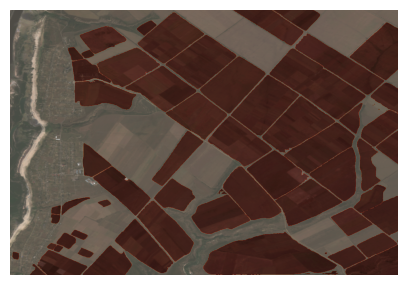

/tmp/ipykernel_1406/1596737097.py:33: RuntimeWarning: invalid value encountered in cast
  rgb_normalized = np.clip((rgb / np.max(rgb)) * 255, 0, 255).astype(np.uint8)


No annotations found for this image.


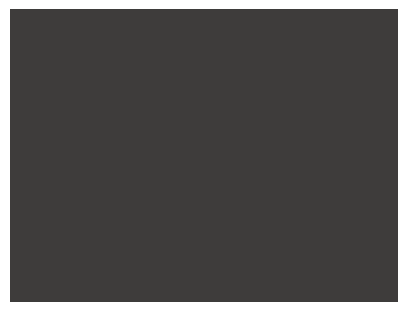

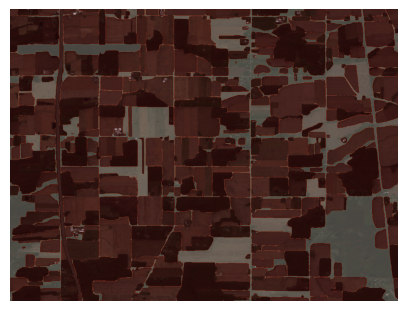

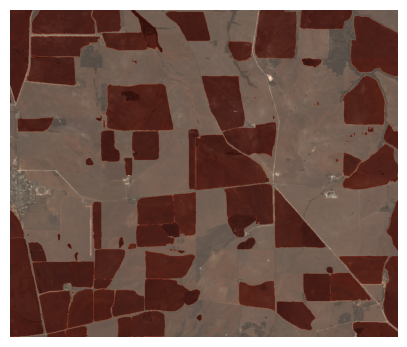

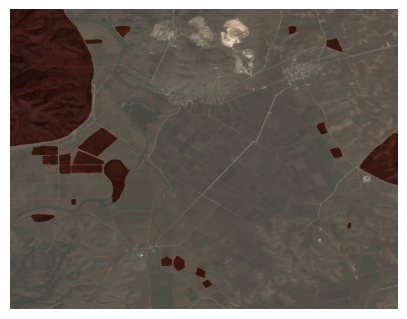

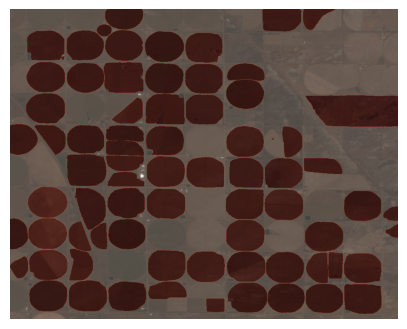

...

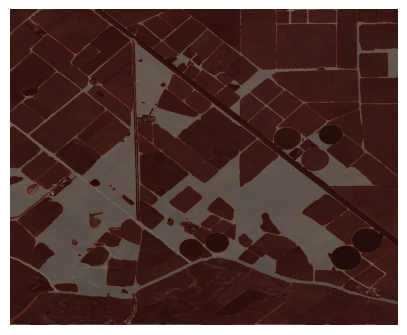

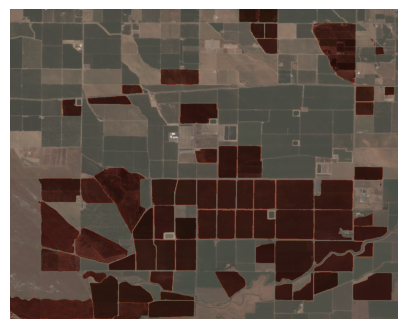

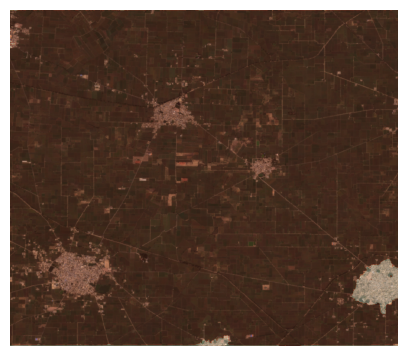

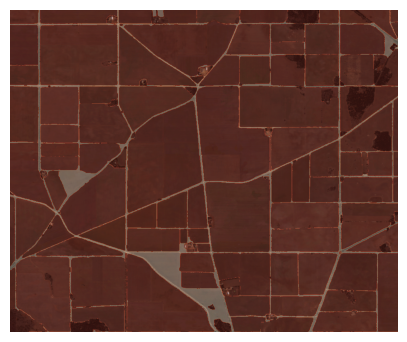

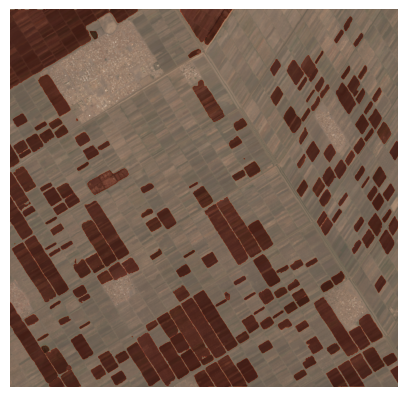

In [22]:
for i in range(50):
    plot_image_with_annotations(f'test_{i}.tif', 'final_predictions_pps_90.json', bucket_name, prefix, is_json_s3=False)

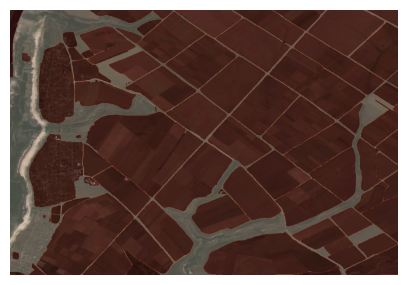

/tmp/ipykernel_1406/1596737097.py:33: RuntimeWarning: invalid value encountered in cast
  rgb_normalized = np.clip((rgb / np.max(rgb)) * 255, 0, 255).astype(np.uint8)


No annotations found for this image.


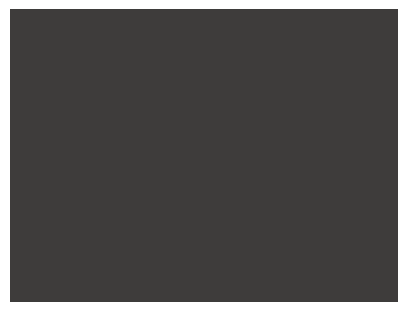

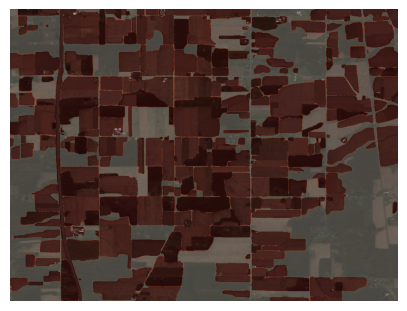

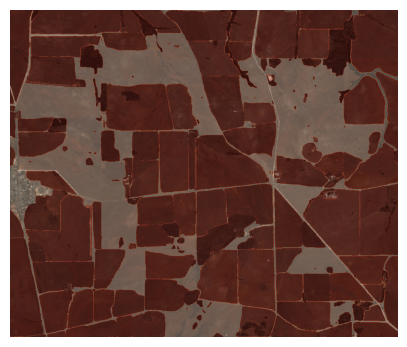

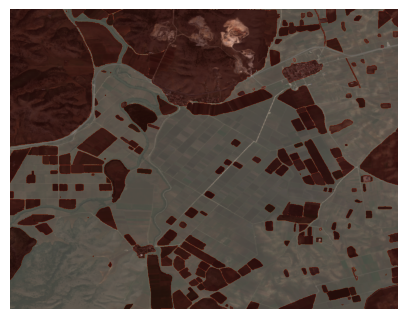

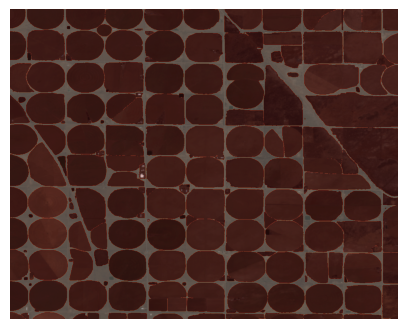

...

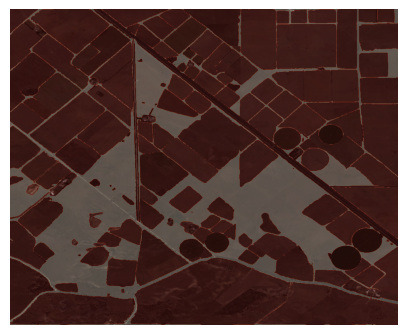

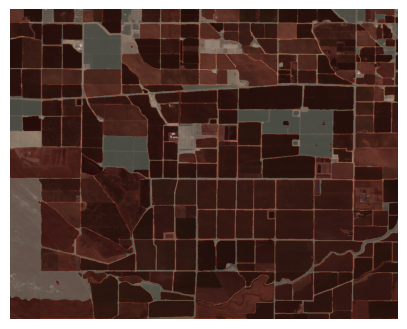

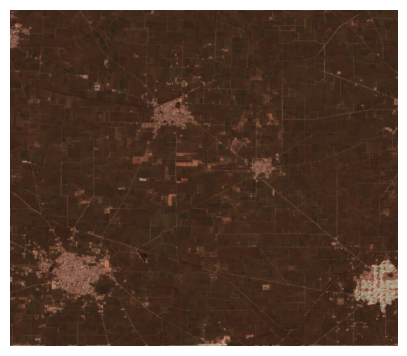

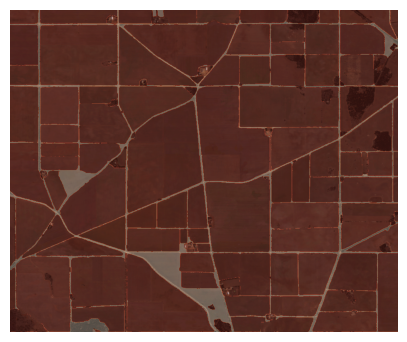

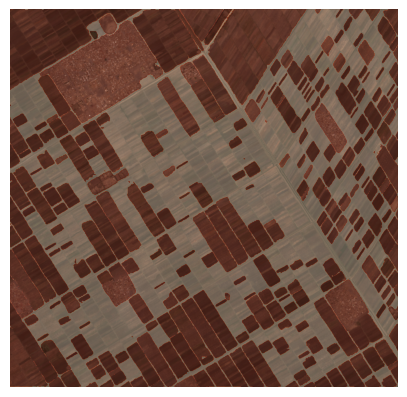

In [24]:
for i in range(50):
    plot_image_with_annotations(f'test_{i}.tif', 'final_predictions_pps_256_ppb_128.json', bucket_name, prefix, is_json_s3=False)